In [1]:
import pickle

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns





In [7]:
DATAFILE = "/work/users/d/j/djpassey/interfere_exp5.1/generative_forecaster_studies.pkl"
with open(DATAFILE, "rb") as f:
    results = pickle.load(f)

/nas/longleaf/home/djpassey/.conda/envs/interfere_exp5/lib/python3.12/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [3]:
studies = results["studies"]
imgs = results["imgs"]

NameError: name 'results' is not defined

In [4]:
METHODS = list(studies.keys())

In [5]:
METRIC_NAMES = [
    "train_vpt", "train_rmse", "train_dir_ch",
    "forecast_vpt", "forecast_rmse", "forecast_dir_ch",
    "interv_vpt", "interv_rmse", "interv_dir_ch"
]

best_trial_rows = []

for method in METHODS:
    for model in studies[method].keys():
        
        model_name = model.split(", ")[1].split("]")[0]
        trials = studies[method][model].trials
        method_rows = [
            [method] + ["Gen[" + model_name +"]"] + trial.values 
            for trial in trials if trial.values
        ]
        best_trial_rows += method_rows
        print(f"Genertor: {model} \nPredictor: {method}\n\tNum trials: {len(method_rows)}")

Genertor: GenForecast[cml, LTSFLinearForecaster] 
Predictor: LTSFLinearForecaster
	Num trials: 25
Genertor: GenForecast[cml, VAR] 
Predictor: LTSFLinearForecaster
	Num trials: 25
Genertor: GenForecast[cml, LSTM] 
Predictor: LTSFLinearForecaster
	Num trials: 25
Genertor: GenForecast[cml, NHITS] 
Predictor: LTSFLinearForecaster
	Num trials: 25
Genertor: GenForecast[cml, ResComp] 
Predictor: LTSFLinearForecaster
	Num trials: 25
Genertor: GenForecast[cml, LTSFLinearForecaster] 
Predictor: VAR
	Num trials: 25
Genertor: GenForecast[cml, VAR] 
Predictor: VAR
	Num trials: 25
Genertor: GenForecast[cml, LSTM] 
Predictor: VAR
	Num trials: 25
Genertor: GenForecast[cml, NHITS] 
Predictor: VAR
	Num trials: 25
Genertor: GenForecast[cml, ResComp] 
Predictor: VAR
	Num trials: 0
Genertor: GenForecast[cml, LTSFLinearForecaster] 
Predictor: LSTM
	Num trials: 25
Genertor: GenForecast[cml, VAR] 
Predictor: LSTM
	Num trials: 25
Genertor: GenForecast[cml, LSTM] 
Predictor: LSTM
	Num trials: 25
Genertor: GenFo

In [6]:
df = pd.DataFrame(
    best_trial_rows,
    columns=["predictor", "generator"] + METRIC_NAMES
)

# Log transform rmse columns.

for metric in ["train_rmse", "forecast_rmse", "interv_rmse"]:
    df[metric] = np.log(df[metric])
    
# Threshold by a max log error.

MAX_ERROR = 10

threshold_df = df[
    (df["train_rmse"] < MAX_ERROR) &
    (df["forecast_rmse"] < MAX_ERROR) &
    (df["interv_rmse"] < MAX_ERROR)
]

# Rename rmse metric cols to log_rmse
threshold_df.rename(columns={
    "train_rmse": "train_log_rmse",
    "forecast_rmse": "forecast_log_rmse",
    "interv_rmse": "interv_log_rmse"
}, inplace=True)

print(
    len(df) - len(threshold_df),
    " / ", len(df),
    " Rows Removed Due to Too Large Error"
)

222  /  693  Rows Removed Due to Too Large Error


/tmp/ipykernel_2032112/2297792334.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  threshold_df.rename(columns={


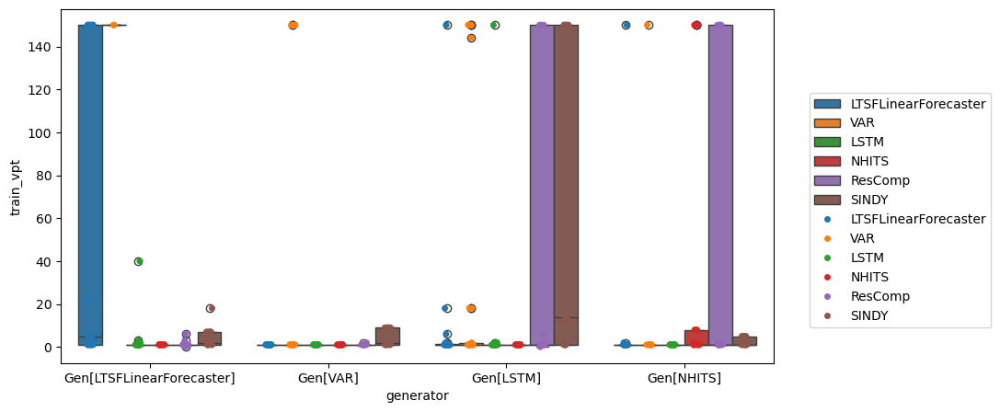

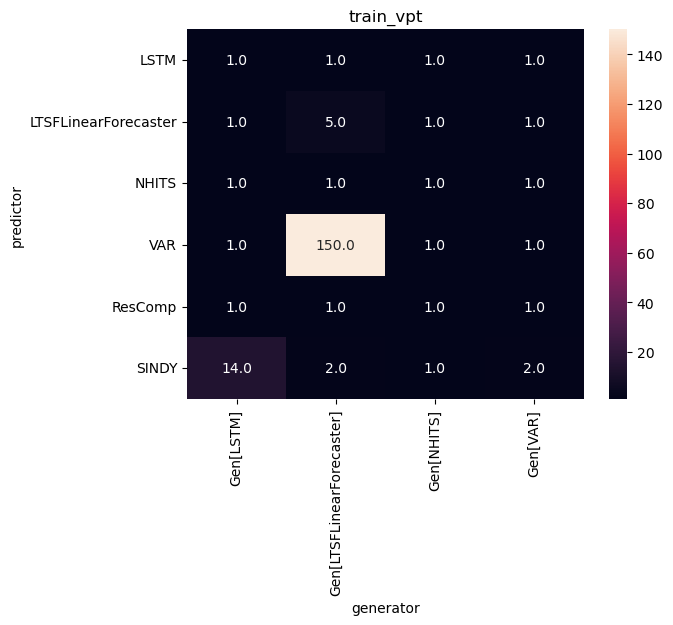

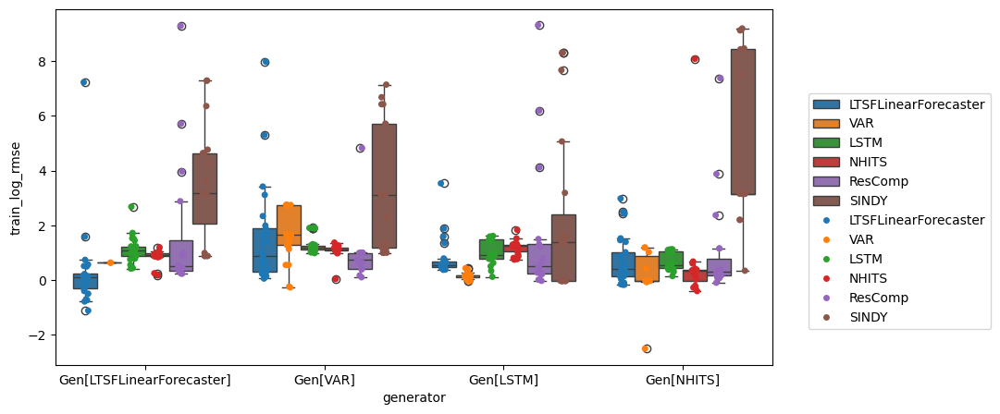

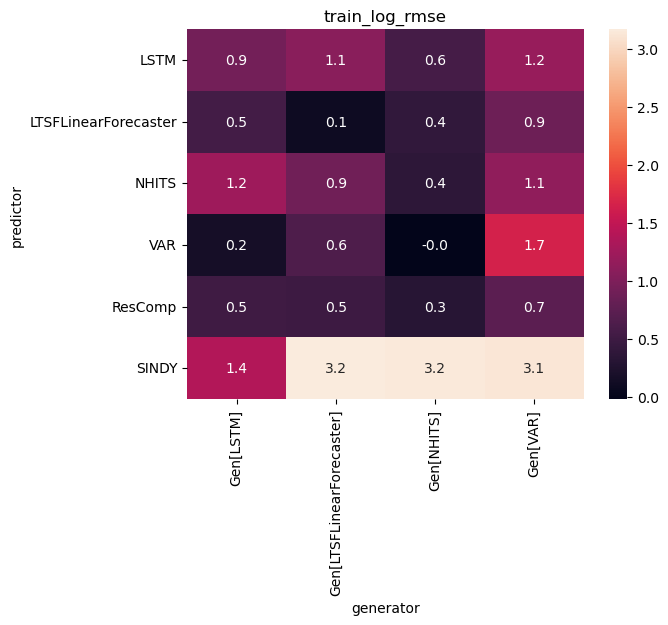

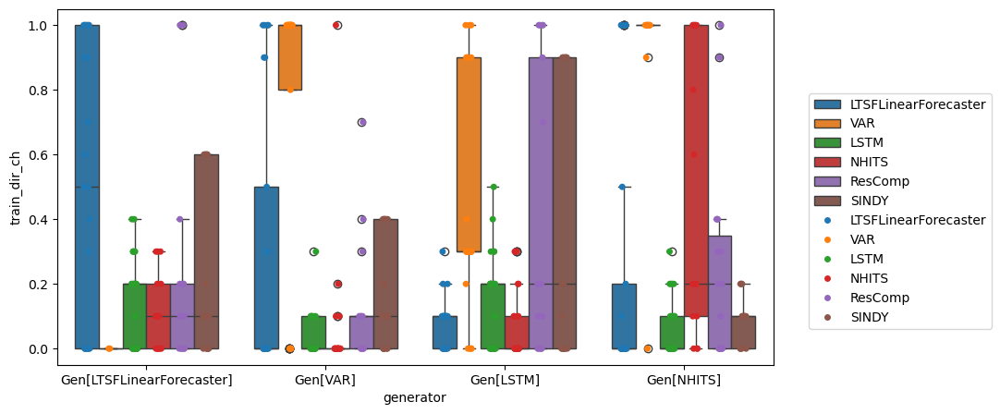

...

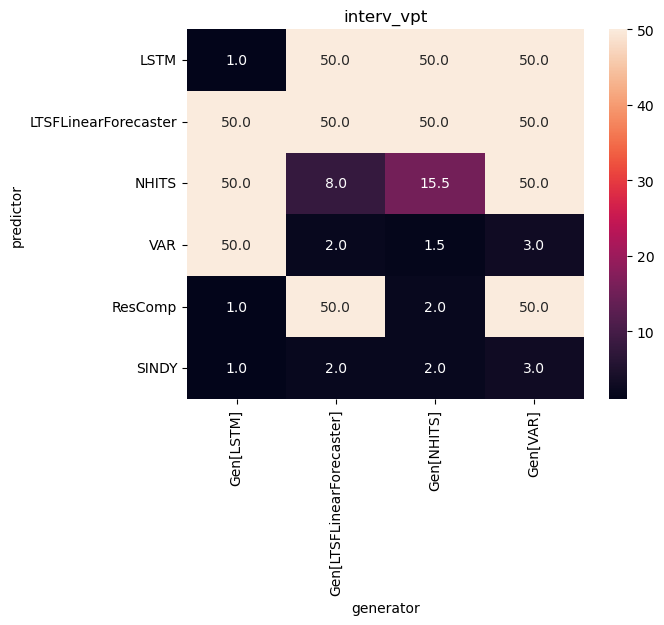

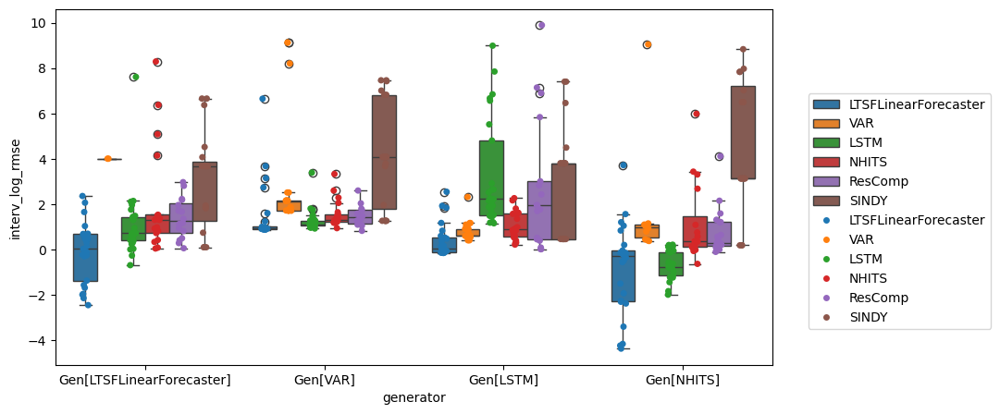

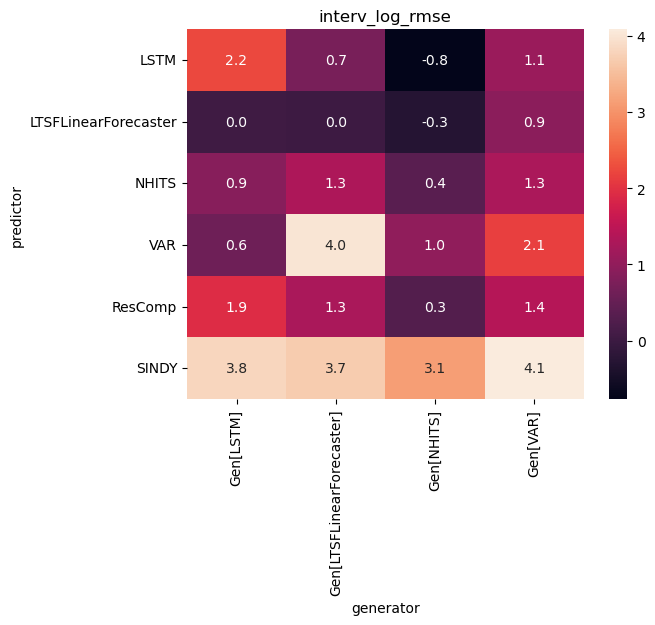

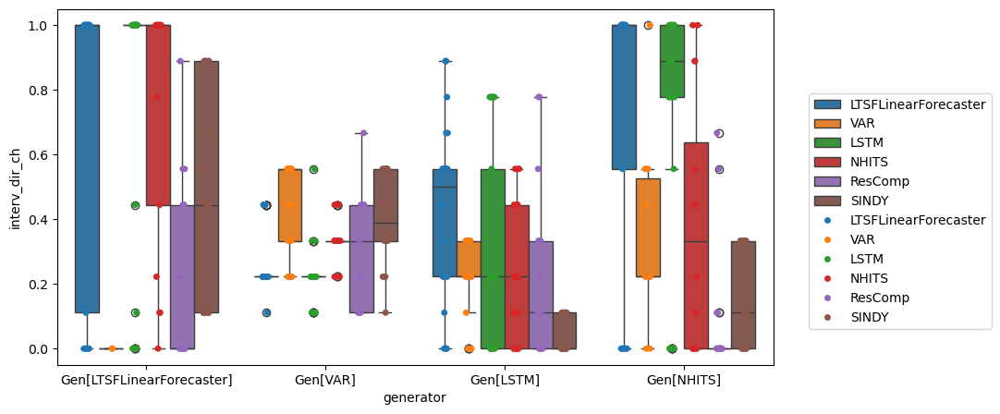

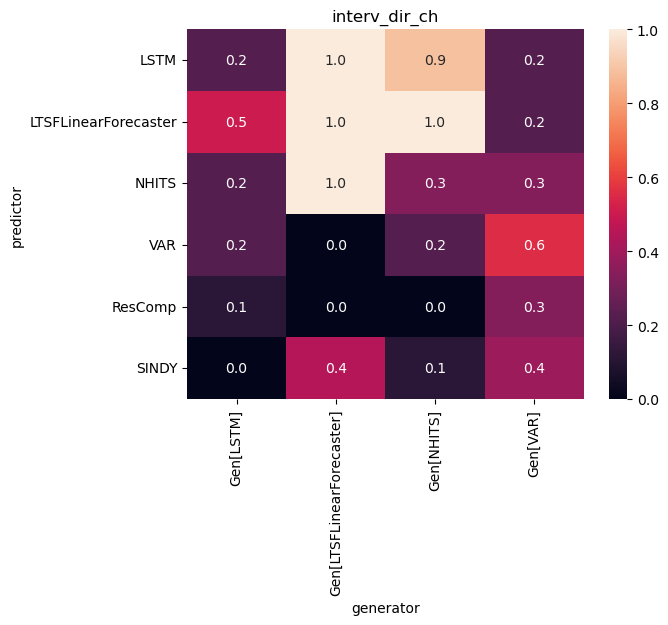

In [10]:
# @title Box + scatter plots of each metric sorted by method and model.
LOG_METRIC_NAMES = [
"train_vpt", "train_log_rmse", "train_dir_ch",
"forecast_vpt", "forecast_log_rmse", "forecast_dir_ch",
"interv_vpt", "interv_log_rmse", "interv_dir_ch"
]

for metric in LOG_METRIC_NAMES:
    fig, ax = plt.subplots(figsize=(10, 5))
    sns.boxplot(x="generator", y=metric, hue="predictor", data=threshold_df, ax=ax)
    sns.stripplot(x="generator", y=metric, hue="predictor", data=threshold_df, ax=ax, jitter=True, dodge=True)
    plt.legend(loc=(1.05, 0.1))
    plt.show()
    
    # Plot the medians in an array
    score_array = np.zeros((5, 4))
    for i, p in enumerate(METHODS[:5]):
        for j, m in enumerate(METHODS[:4]):
            groups = threshold_df.groupby(["predictor", "generator"])[metric].median()
            median_array = groups.unstack().loc[["LSTM","LTSFLinearForecaster",  "NHITS", "VAR", "ResComp", "SINDY"]]
            
            
    sns.heatmap(median_array, annot=True, fmt=".1f")
    plt.title(metric)
    plt.show()

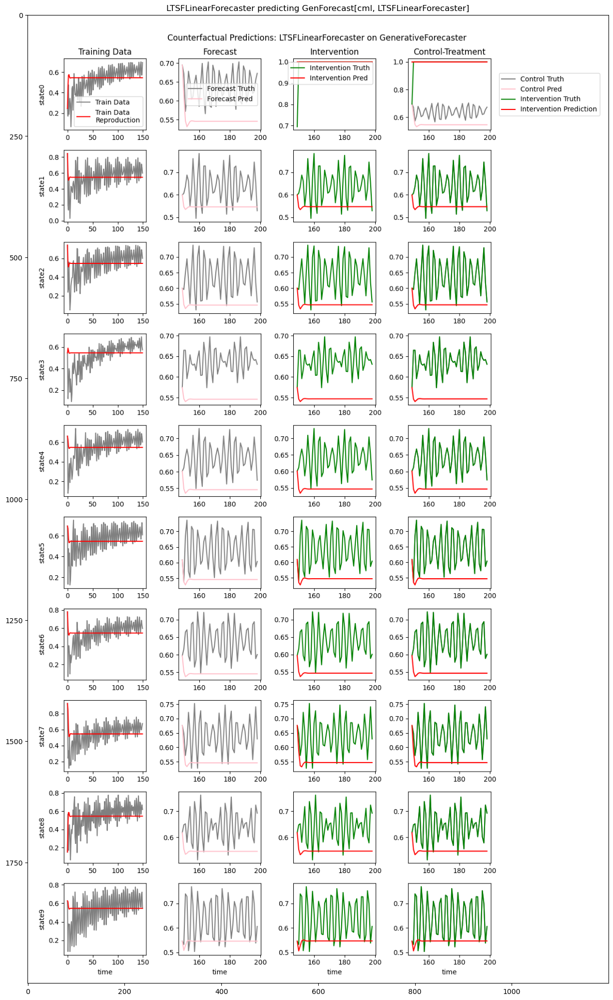

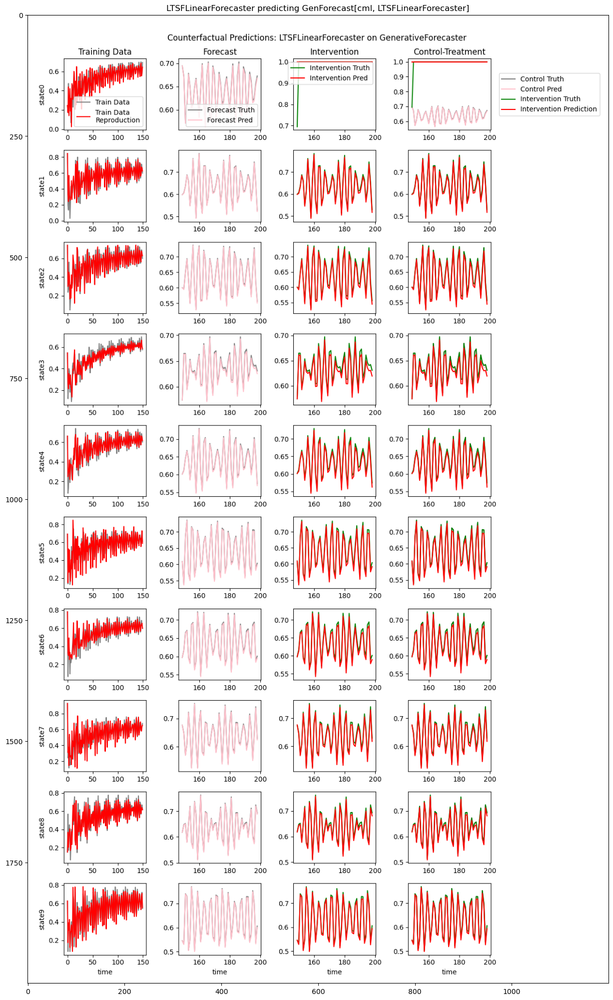

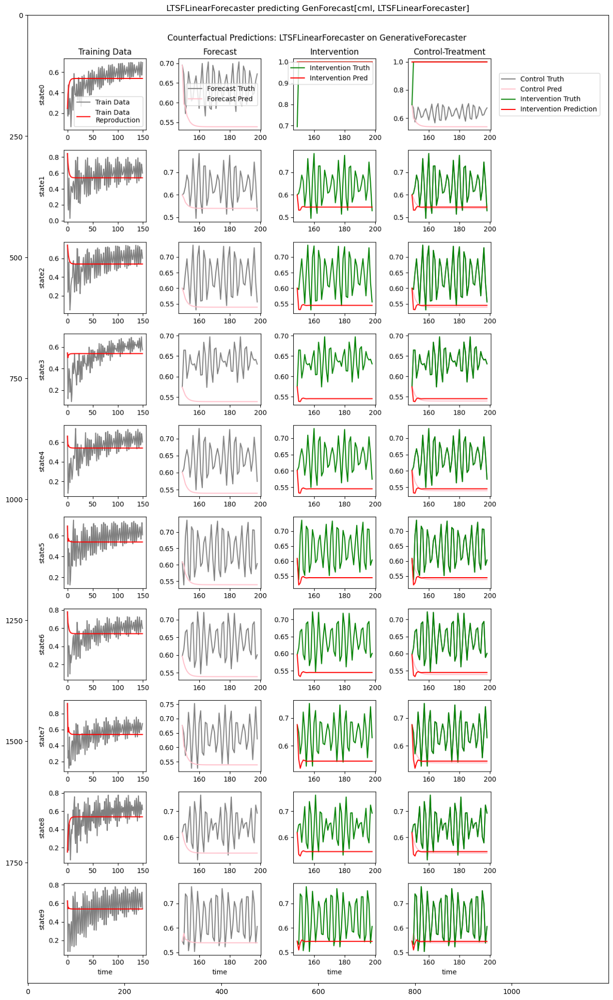

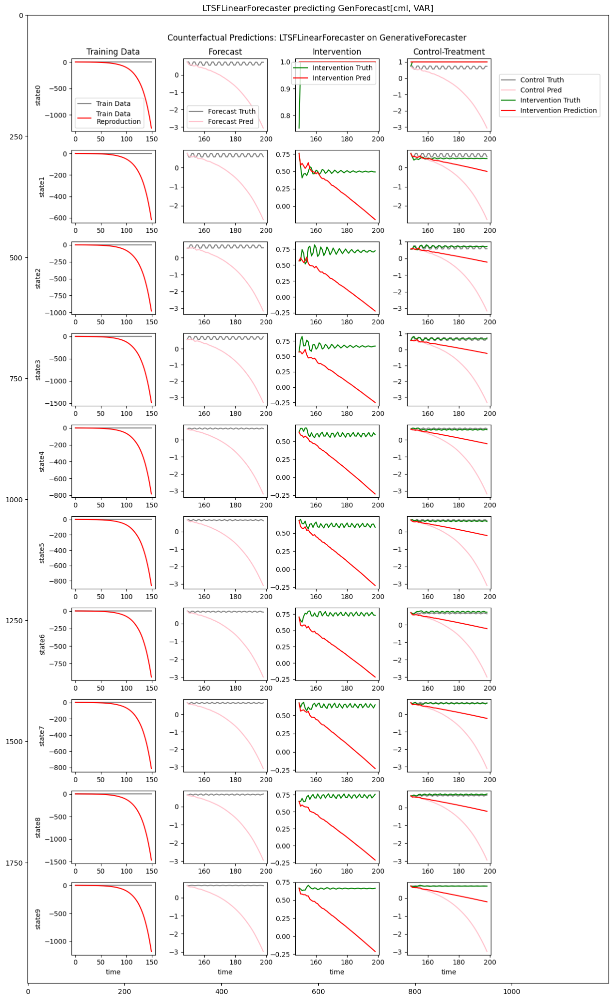

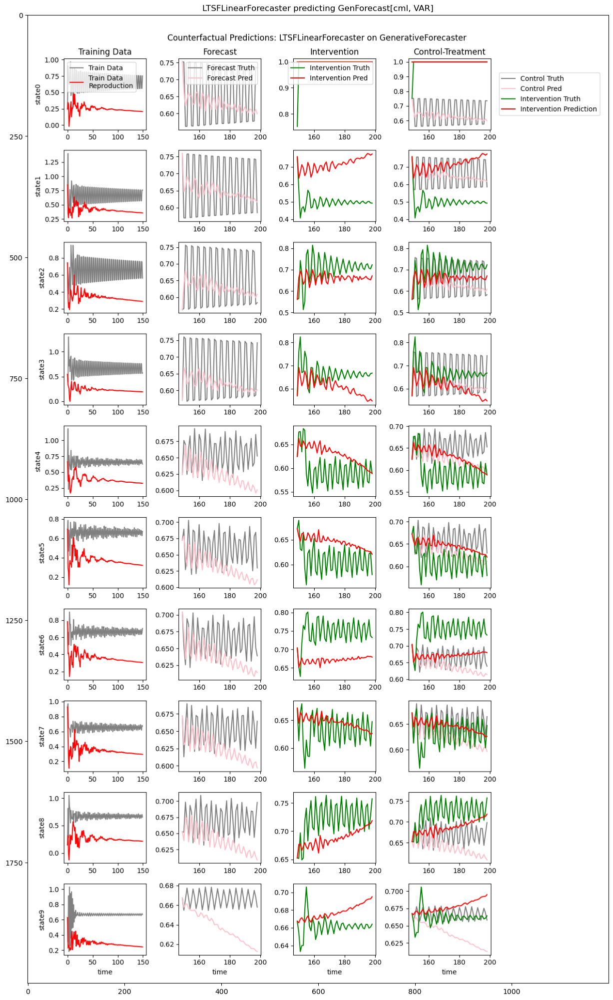

...

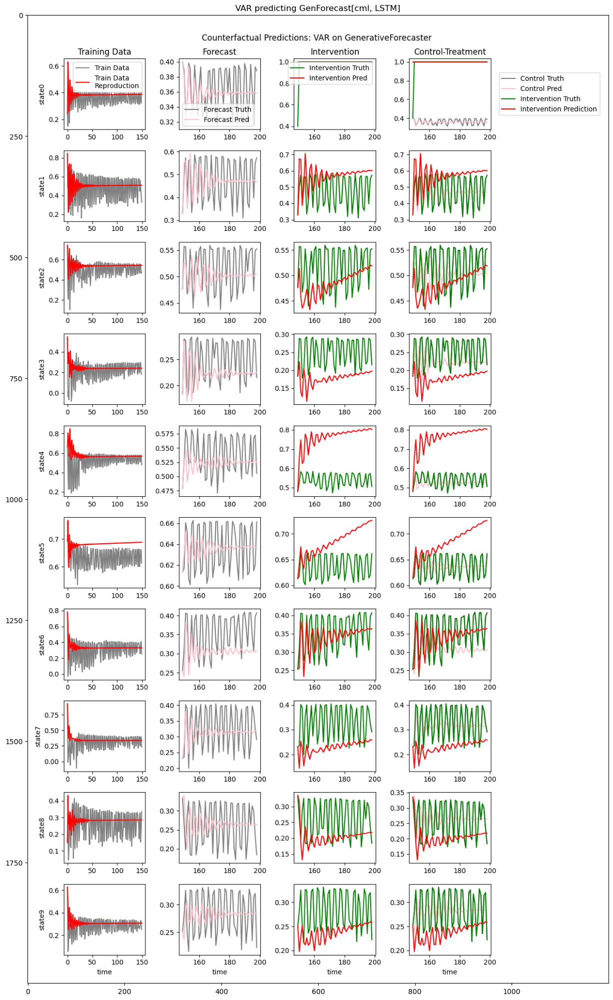

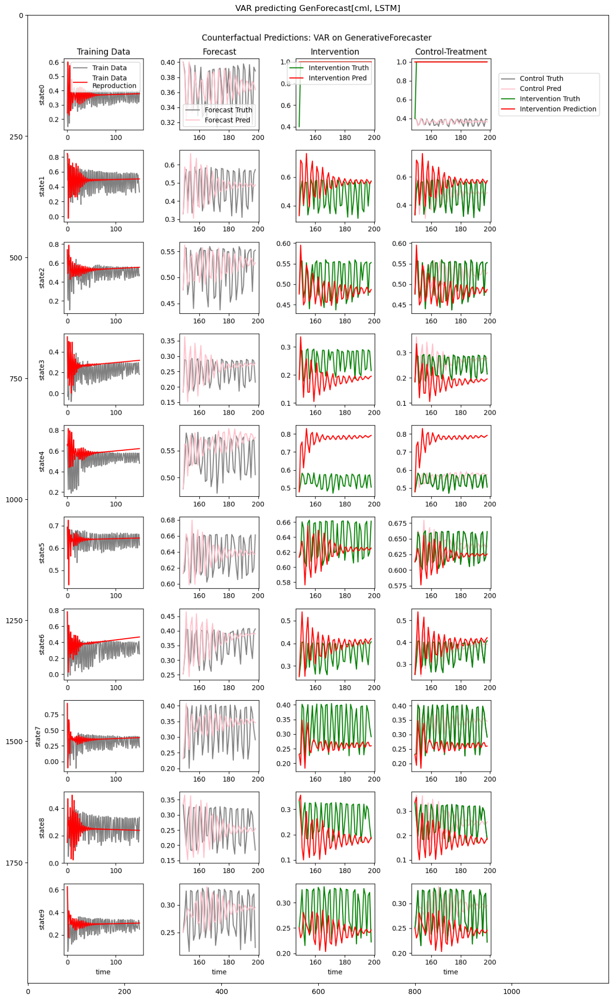

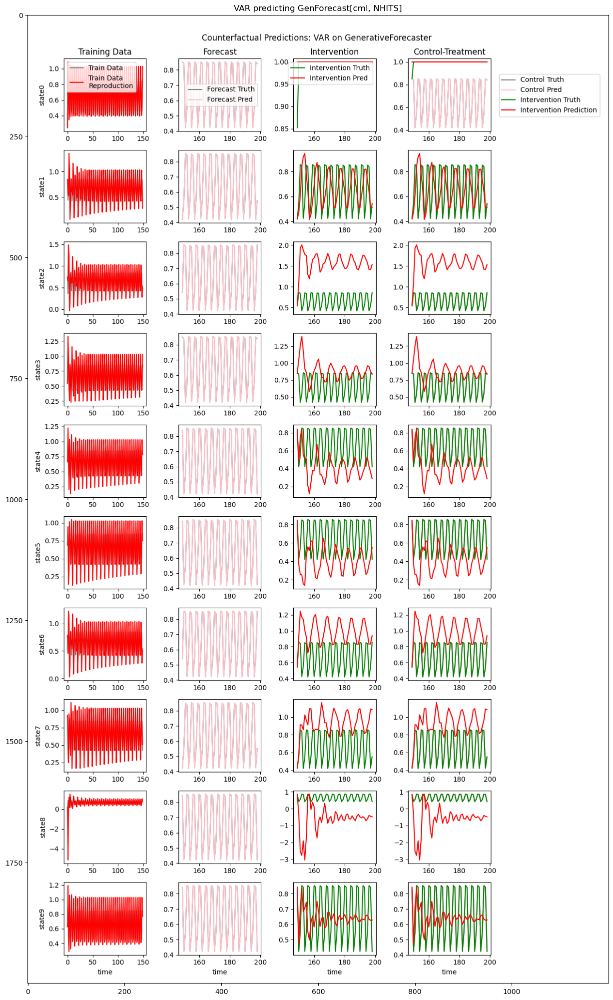

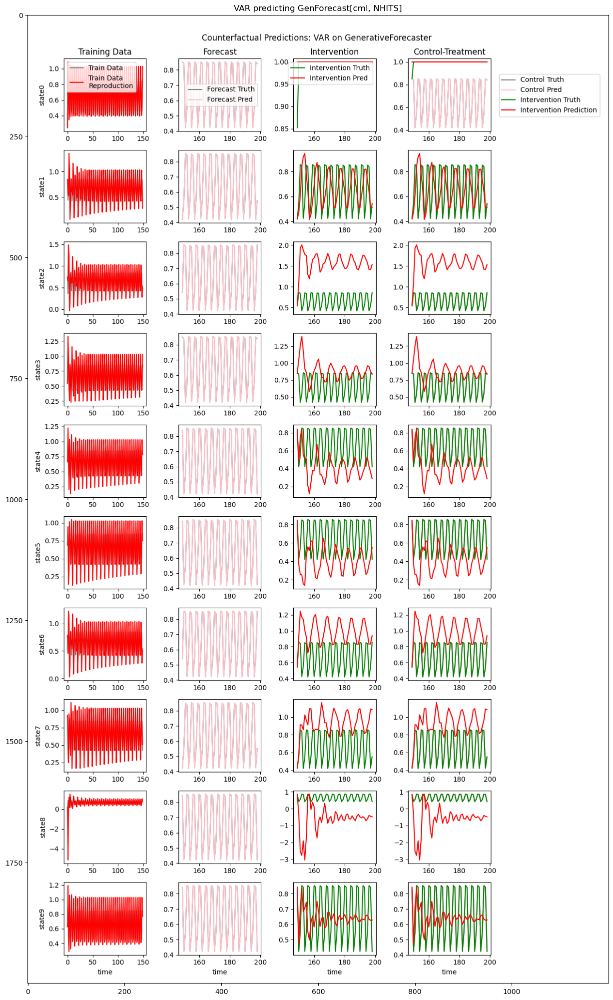

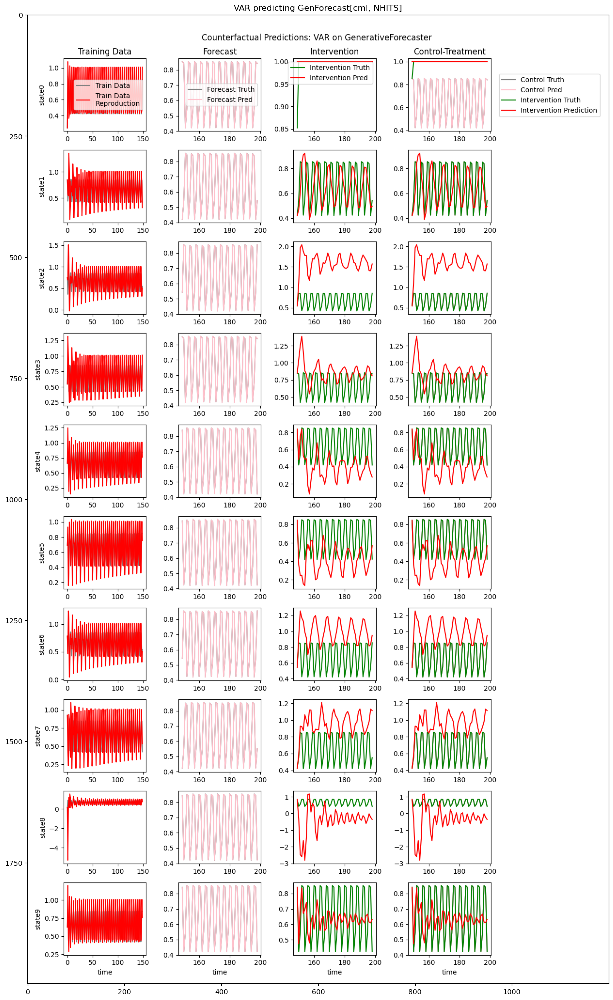

TypeError: Image data of dtype object cannot be converted to float

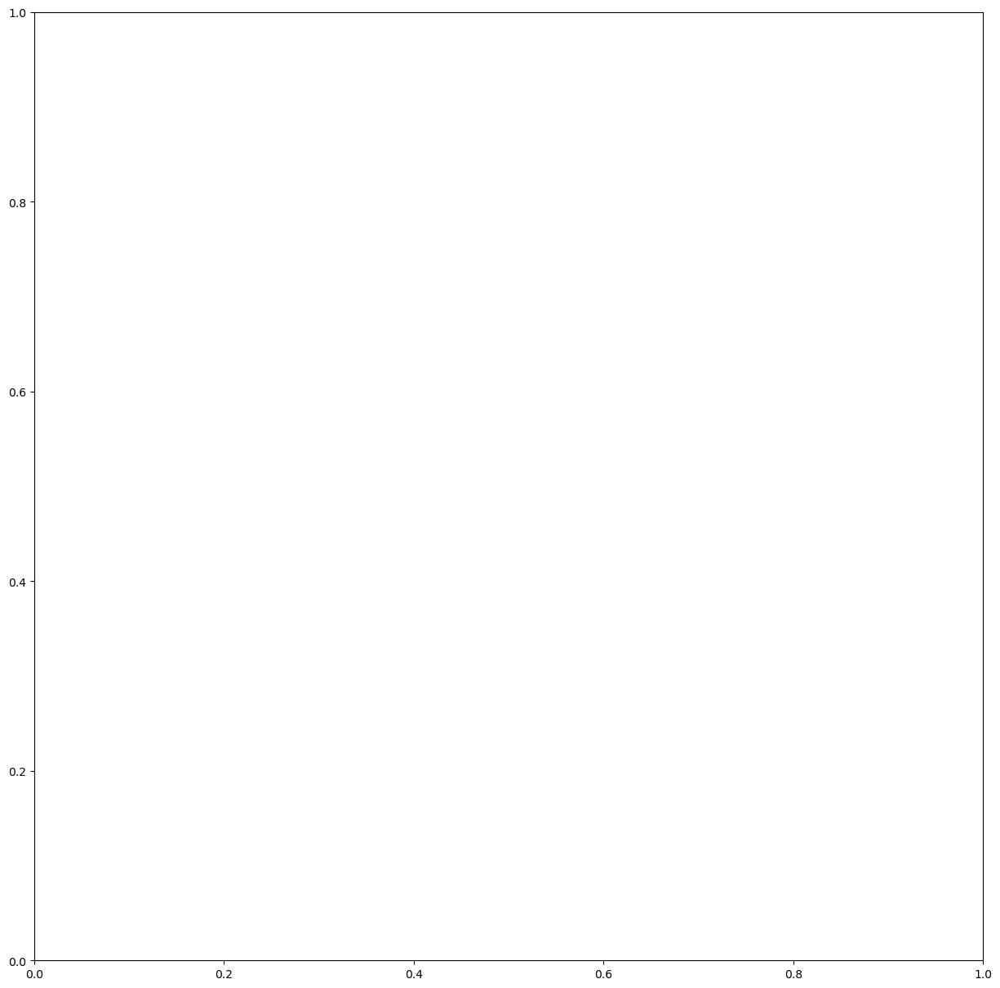

In [13]:
METRIC_NAMES = [
    "train_vpt", "train_rmse", "train_dir_ch",
    "forecast_vpt", "forecast_rmse", "forecast_dir_ch",
    "interv_vpt", "interv_rmse", "interv_dir_ch"
]

best_trial_rows = []

for method in METHODS:
    for model in studies[method].keys():
        
        
        for trial in studies[method][model].trials[-3:]:
            img = imgs[method][model][trial.number]
            if img is not None:
                fig, ax = plt.subplots(figsize=(15, 30))
                ax.imshow(img)
                plt.title(f"{method} predicting {model}")
                plt.show()

        